In [14]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import i0
from scipy.special import i1
from scipy.integrate import solve_ivp
from scipy.optimize import fsolve
from cmath import rect
from scipy.signal import savgol_filter
import seaborn as sns
from scipy.ndimage import convolve1d
from matplotlib import animation
from matplotlib import rc as matrc
from matplotlib import rcParams
from IPython.display import HTML
from scipy.optimize import curve_fit
import custom_plot as cplt

matrc('animation', html='jshtml', embed_limit=20971520*2)

In [2344]:
import importlib
importlib.reload(cplt)

<module 'custom_plot' from '/Users/hoyinchau/Google Drive/berkeley/summer_research/custom_plot.py'>

In [15]:
%autosave 120

Autosaving every 120 seconds


In [731]:
def set_style(tex=False, box=False, ymargin=0.0, xmargin=0.0):
    nice_fonts = {
            # Use LaTeX to write all text
            "text.usetex": tex,
            "font.family": "serif",
            # Use 10pt font in plots, to match 10pt font in document
            "axes.labelsize": 11,
            "font.size": 9,
            # Make the legend/label fonts a little smaller
            "legend.fontsize": 8,
            "xtick.labelsize": 9,
            "ytick.labelsize": 9,
    }
    rcParams.update(nice_fonts)
    rcParams['axes.xmargin'] = xmargin
    rcParams['axes.ymargin'] = ymargin
    rcParams["axes.spines.right"] = box
    rcParams["axes.spines.top"] = box

def M(mu, kappa):
    return lambda x: np.exp(kappa*np.cos(x-mu))/(2*np.pi*i0(kappa))

def Gaussian(mu, sigma, A=None):
    if A is None:
        return lambda x: 1 / np.sqrt(2*np.pi*sigma**2) * np.exp(-(x-mu)**2/(2*sigma**2))
    else:
        return lambda x: A * np.exp(-(x-mu)**2/(2*sigma**2))

def norm(f, kappa, beta):
    """
    Firing rate (normalization) in the continuous theta case and 
    where u(theta) follows von Mises distribution
    """
    c = 1 + beta/(2*np.pi) * i0(2*kappa)/i0(kappa)**2
    return lambda x: f(x)**2 / c

def mean(data, axis=0, weights=None):
    data = np.array(data)
    return np.average(data, axis=axis, weights=weights)
def stddev(data, axis=0, ddof=1, weights=None, delta=None):
    data = np.array(data)
    if weights is not None:
        V = sum(weights)
        avg = mean(data, axis=axis, weights=weights)
        variance = mean((data-avg)**2, axis=axis, weights=weights) * V / (V - ddof)
        dev = np.sqrt(variance)
    else:
        dev = np.std(data, axis=axis, ddof=ddof)
    if delta is None:
        return dev
    delta = np.array(delta)
    return np.sqrt(dev**2 + delta**2)
def stderr(data, axis=0, ddof=1, weights=None, delta=None):
    data = np.array(data)
    if delta is None:
        return stddev(data, axis=axis, ddof=ddof, weights=weights)/np.sqrt(len(data))
    delta = np.array(delta)
    return np.sqrt(sum(stddev(data, axis=axis, ddof=ddof, weights=weights, delta=delta)**2))/len(data)

def estimator(thetas, rates, axis=0, kappa_0=None):
    """
    An estimator for the mean and concentration of a von Mises distribution
    given firing rates of a population of neurons with preferred angle theta
    """
    thetas = np.array(thetas)
    nprect = np.vectorize(rect)
    z = nprect(rates, thetas)
    z_bar = mean(z, axis=axis)
    N = float(len(thetas))
    R = np.sqrt(N/(N-1)*(np.abs(z_bar)**2 - 1/N))
    func = lambda kappa: R - i1(kappa)/i0(kappa)
    if kappa_0 is None:
        if axis != 0:
            kappa_0 = [0.0 for _ in range(np.size(thetas, axis=axis-1))]
        else:
            kappa_0 = 0.0
    kappa = fsolve(func, kappa_0)
    if len(kappa) == 1:
        kappa = kappa[0]
    return [np.angle(z_bar), kappa]

def perm_mat(size, k):
    """
    Returns a permutation matrix that shifts element
    to the right by k along the first axis
    """
    a = np.zeros(size)
    for i, row in enumerate(a):
        index = (i+k) % len(a)
        row[index] = 1
    return a

def my_reset(*varnames):
    """
    varnames are what you want to keep
    """
    globals_ = globals()
    to_save = {v: globals_[v] for v in varnames}
    to_save['my_reset'] = my_reset  # lets keep this function by default
    del globals_
    get_ipython().magic("reset")
    globals().update(to_save)
    
def calc_corr(a, b):
    a_bar = mean(a)
    b_bar = mean(b)
    return np.dot(a-a_bar, b-b_bar)/(np.linalg.norm(a-a_bar)*np.linalg.norm(b-b_bar))

In [716]:
def r(ui, u, omega, t=0.0):
    """
    Firing rate (normalization) of ui in the discrete theta case,
    as a function of all neurons' u, and parameter omega.
    """
    threshold = np.full(len(u), t)
    zeros = np.zeros(len(u))
    return np.maximum(ui - t, 0)**2.0 / (1 + omega * np.sum(np.maximum(u - threshold, zeros)**2.0))

def vM_random_walk(n, mu=0.0, kappa=10.0):
    """
    Returns a random walk with length n where each stepsize is
    distributed according to von Mises distrution.
    """
    vm = np.random.vonmises(mu, kappa, size=n)
    return np.cumsum(vm)

def OU_process(n, mu=0.0, kappa=0.5, tau=15.0):
    """
    Returns a Ornstein-Uhlenbeck process with length n where each stepsize is
    distributed according to von Mises distrution. Recommend tau > 10.0
    """
    x = np.zeros(n)
    x[0] = mu
    dt = 1.0
    for i in range(n-1):
        x[i+1] = x[i] - dt * 1/tau * (x[i] - mu) + np.random.vonmises(0.0, kappa) * np.sqrt(dt)
    return x

def init_weights(N, mu, sigma, thetas):
    strengths = np.random.lognormal(mean=mu, sigma=sigma, size=N)
    w = np.zeros((N,N))
    for i, theta in enumerate(thetas):
        distrb = lambda thetas: strengths[i] * M(theta, 2)(thetas)
        w[i] = np.maximum(distrb(thetas) + np.random.normal(size=N, scale=np.sqrt(0.5*distrb(thetas))), np.zeros(N))
    np.random.shuffle(w)
    return w.T.flatten()

def Newton(f, y0, ts, save_ts, progress=True):
    ys = np.zeros((len(save_ts), len(y0)))
    r1_in_save = np.zeros((len(save_ts), N))
    r2_in_save = np.zeros((len(save_ts), N))
    y = y0
    dt = ts[1] - ts[0]
    k = -1
    skip = int(round(len(ts)/(len(save_ts)-1)))
    avgs = np.zeros((4,N))
    all_rc = np.zeros((len(ts)+1,N))
    all_ro = np.zeros((len(ts)+1,N))
    for i, t in enumerate(ts):
        if progress is True:
            print("Iteration: ", i)
        if i % skip == 0:
            k += 1
            ys[k] = y
            r1_in_save[k] = r1_in[i]
            r2_in_save[k] = r2_in[i]
        uc, uo = y[:N], y[N:2*N]
        all_rc[i], all_ro[i] = r(uc, uc, omega), r(uo, uo, omega)
        
        y = y + dt*f(t, y, i, avgs, all_rc)
        
        # Set excitatory synapses to non-negative, inhibitory to non-positive
        w, thc, tho = y[2*N:-2*N], y[-2*N:-N], y[-N:]
        assert len(w) == 4*N*N
        wpos, wneg = w[:3*N*N], w[3*N*N:]
        wpos, wneg = np.maximum(wpos, np.zeros(3*N*N)), np.maximum(wneg, np.zeros(N*N))
        w = np.concatenate((wpos, wneg))
        y[2*N:-2*N] = w
        
#         # Set threshold to non-negative
#         assert len(thc) == N and len(tho) == N
#         thc, tho = np.maximum(thc, np.zeros(N)), np.maximum(tho, np.zeros(N))
#         y[-2*N:-N] = thc
#         y[-N:] = tho
        
        # Calculate running average of rc and ro.
        totals = avgs * i
        u = y[:2*N]
        uc, uo = u[:N], u[N:]
        rc, ro = r(uc, uc, omega), r(uo, uo, omega)
        totals = totals + np.array([uc, uo, rc, ro])
        avgs = totals / float(i+1)
        
    ys[-1] = y
    uc, uo = y[:N], y[N:2*N]
    all_rc[-1], all_ro[-1] = r(uc, uc, omega), r(uo, uo, omega)
    return (save_ts, ys, r1_in_save, r2_in_save, [all_rc, all_ro])

**New Model**

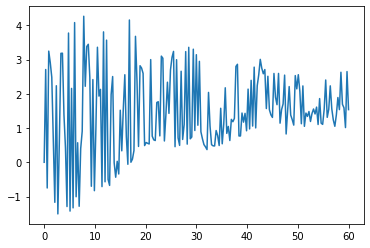

In [19]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 3.0 # Input concentration of modality 1
a2_in = 3.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 2.1e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.1 * tau # simulation timestep
tau_we = 5.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 5.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 60.0 # simulation time
save_interval = 300 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 4.5
Ibo = 1.7
alpha = 5.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
# OLD
# s_ = np.linspace(-180.0, 180.0, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s__ = np.array([np.deg2rad(OU_process(N_small, mu=angle)) for angle in s_]).flatten()
# s1 = np.array([[angle for _ in range(10)] for angle in s__]).flatten()

# NEW
# s_ = np.linspace(-np.pi, np.pi, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s1 = np.repeat(s_, N_repeats) + np.random.normal(0.0, np.deg2rad(2.0), size=n)
s1 = new_s1[:n]

# Generate stimulus location for modality 2
s2 = s1 + np.random.normal(0.0, np.deg2rad(2.0), size=n)

# Convert stimulus location to firing rate
lamb = lambda s, R, a: lambda theta_j: R*np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R1; conc - a1_in
r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R2; conc - a2_in
# r1_in = np.concatenate((new_r1_in, new_r1_in, new_r1_in))
# r2_in = np.concatenate((new_r2_in, new_r2_in, new_r1_in))
# r1_in = new_r1_in[:]
# r2_in = new_r2_in[:]

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
# a_mu = 0.3
# a_var = 0.1
# mu = np.log(a_mu**2/np.sqrt(a_var + a_mu**2))
# sigma = np.log(1+a_var/a_mu**2)
# wc10 = init_weights(N, mu, sigma, thetas)
# wc20 = init_weights(N, mu, sigma, thetas)
# wo10 = init_weights(N, mu, sigma, thetas)
# wo20 = init_weights(N, mu, sigma, thetas)
# w0 = np.concatenate((wc10, wc20, wo10, wo20))
w0 = np.concatenate((wc10.flatten(), wc20.flatten(), wo10.flatten(), wo20.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = np.zeros(N), np.zeros(N)
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = 1/tau_b * (Ibc - uc)
    dubodt = 1/tau_b * (Ibo - uo)
    ducdt = 1/tau * (-uc + ubc + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + ubo + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = 1/tau_we * (np.outer(rc, r1_in[i-1]) - np.multiply(rc, alpha*wc1.T).T)
    dwc2dt = 1/tau_we * (np.outer(rc, r2_in[i-1]) - np.multiply(rc, alpha*wc2.T).T)
    dwo1dt = 1/tau_we * (np.outer(ro, r1_in[i-1]) - np.multiply(ro, alpha*wo1.T).T)
    dwo2dt = 1/tau_wi * (np.outer(ro, all_rc[j-1]) - np.multiply(ro, 0.6*alpha*wo2.T).T) # anti-Hebbian

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

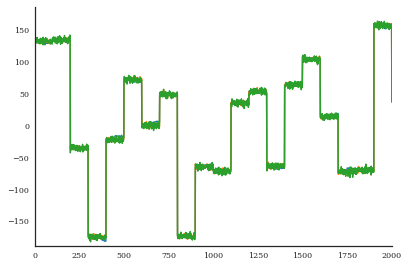

In [2240]:
k = 100
# new_process = np.repeat(new_s1[::k],k)
# new_process = new_process + np.random.normal(0, np.deg2rad(2.0), size=len(new_process))
plt.plot(range(len(new_s1)), np.rad2deg(new_s1))
plt.plot(range(len(new_process)), np.rad2deg(new_process))
plt.plot(range(len(new_process)), np.rad2deg(new_process + np.random.normal(0.0, np.deg2rad(2.0), size=n)))
# plt.ylim(120,150)
plt.xlim(0,2000)
plt.show()

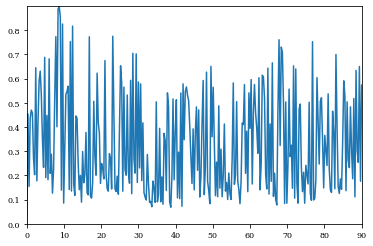

In [510]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 3.0 # Input concentration of modality 1
a2_in = 3.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.1 * tau # simulation timestep
tau_we = 15.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 15.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 90.0 # simulation time
save_interval = 300 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 30.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
# OLD
# s_ = np.linspace(-180.0, 180.0, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s__ = np.array([np.deg2rad(OU_process(N_small, mu=angle)) for angle in s_]).flatten()
# s1 = np.array([[angle for _ in range(10)] for angle in s__]).flatten()

# NEW
# s_ = np.linspace(-np.pi, np.pi, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s1 = np.repeat(s_, N_repeats) + np.random.normal(0.0, np.deg2rad(2.0), size=n)
s1 = np.concatenate([new_s1 for _ in range(2)])[:n]

# Generate stimulus location for modality 2
s2 = s1 + np.random.normal(0.0, np.deg2rad(2.0), size=n)

# Convert stimulus location to firing rate
lamb = lambda s, R, a: lambda theta_j: R*np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R1; conc - a1_in
r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R2; conc - a2_in
# r1_in = np.concatenate((new_r1_in, new_r1_in, new_r1_in))
# r2_in = np.concatenate((new_r2_in, new_r2_in, new_r1_in))
# r1_in = new_r1_in[:]
# r2_in = new_r2_in[:]

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
# a_mu = 0.3
# a_var = 0.1
# mu = np.log(a_mu**2/np.sqrt(a_var + a_mu**2))
# sigma = np.log(1+a_var/a_mu**2)
# wc10 = init_weights(N, mu, sigma, thetas)
# wc20 = init_weights(N, mu, sigma, thetas)
# wo10 = init_weights(N, mu, sigma, thetas)
# wo20 = init_weights(N, mu, sigma, thetas)
# w0 = np.concatenate((wc10, wc20, wo10, wo20))
w0 = 1.0/5.0*np.concatenate((wc10.flatten(), wc20.flatten(), wo10.flatten(), wo20.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = np.zeros(N), np.zeros(N)
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = 1/tau_b * (Ibc - uc)
    dubodt = 1/tau_b * (Ibo - uo)
    ducdt = 1/tau * (-uc - 0.3 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + 0.2 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = 1/tau_we * (np.outer(rc, r1_in[i-1]) - np.multiply(rc, alpha*wc1.T).T)
    dwc2dt = 1/tau_we * (np.outer(rc, r2_in[i-1]) - np.multiply(rc, alpha*wc2.T).T)
    dwo1dt = 1/tau_we * (np.outer(ro, r1_in[i-1]) - np.multiply(ro, alpha*wo1.T).T)
    dwo2dt = 1/tau_wi * (np.outer(ro, all_rc[j-1]) - np.multiply(ro, alpha*wo2.T).T) # anti-Hebbian

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

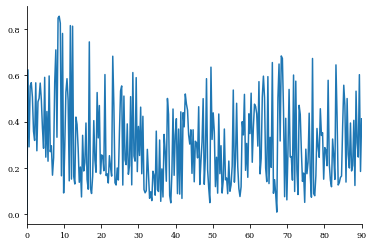

In [528]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 2.0 # Input concentration of modality 1
a2_in = 2.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.1 * tau # simulation timestep
tau_we = 10.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 10.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 90.0 # simulation time
save_interval = 300 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 20.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
# OLD
# s_ = np.linspace(-180.0, 180.0, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s__ = np.array([np.deg2rad(OU_process(N_small, mu=angle)) for angle in s_]).flatten()
# s1 = np.array([[angle for _ in range(10)] for angle in s__]).flatten()

# NEW
# s_ = np.linspace(-np.pi, np.pi, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s1 = np.repeat(s_, N_repeats) + np.random.normal(0.0, np.deg2rad(2.0), size=n)
s1 = np.concatenate([new_s1 for _ in range(2)])[:n]

# Generate stimulus location for modality 2
s2 = s1 + np.random.normal(0.0, np.deg2rad(2.0), size=n)

# Convert stimulus location to firing rate
lamb = lambda s, R, a: lambda theta_j: R*np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R1; conc - a1_in
r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R2; conc - a2_in
# r1_in = np.concatenate((new_r1_in, new_r1_in, new_r1_in))
# r2_in = np.concatenate((new_r2_in, new_r2_in, new_r1_in))
# r1_in = new_r1_in[:]
# r2_in = new_r2_in[:]

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
# a_mu = 0.3
# a_var = 0.1
# mu = np.log(a_mu**2/np.sqrt(a_var + a_mu**2))
# sigma = np.log(1+a_var/a_mu**2)
# wc10 = init_weights(N, mu, sigma, thetas)
# wc20 = init_weights(N, mu, sigma, thetas)
# wo10 = init_weights(N, mu, sigma, thetas)
# wo20 = init_weights(N, mu, sigma, thetas)
# w0 = np.concatenate((wc10, wc20, wo10, wo20))
w0 = 1.0/5.0*np.concatenate((wc10.flatten(), wc20.flatten(), wo10.flatten(), wo20.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = np.zeros(N), np.zeros(N)
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = 1/tau_b * (Ibc - uc)
    dubodt = 1/tau_b * (Ibo - uo)
    ducdt = 1/tau * (-uc - 0.7 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + 0.2 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = 1/tau_we * (np.outer(rc, r1_in[i-1]) - np.multiply(rc, alpha*wc1.T).T)
    dwc2dt = 1/tau_we * (np.outer(rc, r2_in[i-1]) - np.multiply(rc, alpha*wc2.T).T)
    dwo1dt = 1/tau_we * (np.outer(ro, r1_in[i-1]) - np.multiply(ro, alpha*wo1.T).T)
    dwo2dt = 1/tau_wi * (np.outer(ro, all_rc[j-1]) - np.multiply(ro, alpha*wo2.T).T) # anti-Hebbian

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

In [ ]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 1.5 # Input concentration of modality 1
a2_in = 1.5 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.1 * tau # simulation timestep
tau_we = 10.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 10.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 120.0 # simulation time
save_interval = 300 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.00
Ibo = 0.25
alpha = 15.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
# OLD
# s_ = np.linspace(-180.0, 180.0, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s__ = np.array([np.deg2rad(OU_process(N_small, mu=angle)) for angle in s_]).flatten()
# s1 = np.array([[angle for _ in range(10)] for angle in s__]).flatten()

# NEW
# s_ = np.linspace(-np.pi, np.pi, num=N_big, endpoint=False)
# np.random.shuffle(s_)
# s1 = np.repeat(s_, N_repeats) + np.random.normal(0.0, np.deg2rad(2.0), size=n)
s1 = np.concatenate([new_s1 for _ in range(2)])[:n]

# Generate stimulus location for modality 2
s2 = s1 + np.random.normal(0.0, np.deg2rad(2.0), size=n)

# Convert stimulus location to firing rate
lamb = lambda s, R, a: lambda theta_j: R*np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R1; conc - a1_in
r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)]) # max firing rate - R2; conc - a2_in
# r1_in = np.concatenate((new_r1_in, new_r1_in, new_r1_in))
# r2_in = np.concatenate((new_r2_in, new_r2_in, new_r1_in))
# r1_in = new_r1_in[:]
# r2_in = new_r2_in[:]

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
# a_mu = 0.3
# a_var = 0.1
# mu = np.log(a_mu**2/np.sqrt(a_var + a_mu**2))
# sigma = np.log(1+a_var/a_mu**2)
# wc10 = init_weights(N, mu, sigma, thetas)
# wc20 = init_weights(N, mu, sigma, thetas)
# wo10 = init_weights(N, mu, sigma, thetas)
# wo20 = init_weights(N, mu, sigma, thetas)
# w0 = np.concatenate((wc10, wc20, wo10, wo20))
w0 = 1.0/5.0*np.concatenate((wc10.flatten(), wc20.flatten(), wo10.flatten(), wo20.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = np.zeros(N), np.zeros(N)
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = 1/tau_b * (Ibc - uc)
    dubodt = 1/tau_b * (Ibo - uo)
#     dubodt = np.zeros(N)
#     dubcdt = np.zeros(N)
    ducdt = 1/tau * (-uc - 1.2 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + 0.15 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = 1/tau_we * (np.outer(rc, r1_in[i-1]) - np.multiply(rc, alpha*wc1.T).T)
    dwc2dt = 1/tau_we * (np.outer(rc, r2_in[i-1]) - np.multiply(rc, alpha*wc2.T).T)
    dwo1dt = 1/tau_we * (np.outer(ro, r1_in[i-1]) - np.multiply(ro, alpha*wo1.T).T)
    dwo2dt = 1/tau_wi * (np.outer(ro, all_rc[j-1]) - np.multiply(ro, alpha*wo2.T).T) # anti-Hebbian

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

In [775]:
np.savetxt("new_data.csv", ys)

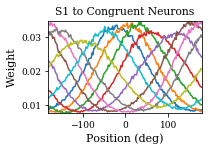

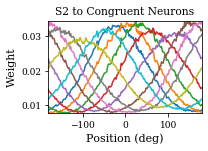

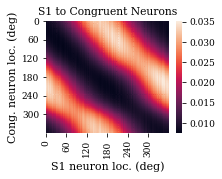

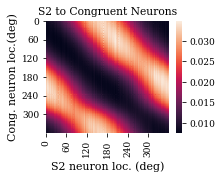

105
1
0.9829689747250043


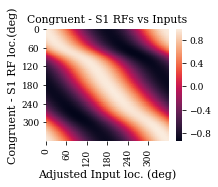

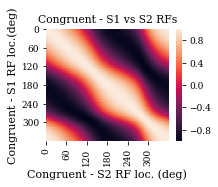

In [824]:
set_style(box=True)
y = ys[-1]
l = 2*N
u, w = y[:l], y[l:]
l = N
uc, uo = u[:l], u[l:]
# rc, ro = [r(uci, uc, omega) for uci in uc], [r(uoi, uo, omega) for uoi in uo]
l = N*N
wc1, wc2, wo1, wo2 = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("S1 to Congruent Neurons")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), wc1[i])
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/wc1_RF.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("S2 to Congruent Neurons")
for i in range(0, 180, 18):
    plt.plot(np.rad2deg(thetas), wc2[i])
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/wc2_RF.pdf")
plt.show()
swc1, swc2 = np.zeros((N,N)), np.zeros((N,N))
for i in range(len(wc1)):
    swc1[i] = savgol_filter(wc1[i], 21, 1)
    swc2[i] = savgol_filter(wc2[i], 21, 1)

ideal = np.array([[W(1.0, a1_in)(theta1, theta2) for theta2 in thetas] for theta1 in thetas])
corr = np.corrcoef(wc1, ideal)[:N,N:]
corr2 = np.corrcoef(wc2, ideal)[:N,N:]
best_corr = np.corrcoef(ideal, ideal)[:N,N:]
corr12 = np.corrcoef(wc1, wc2)[:N,N:]
best_corr12 = np.corrcoef(wc1, wc1)[:N,N:]

plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
sns.heatmap(wc1)
plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.title("S1 to Congruent Neurons")
plt.ylabel("Cong. neuron loc. (deg)")
plt.xlabel("S1 neuron loc. (deg)")
# plt.savefig("Manuscript/Figures/wc1_matrix.png")
# cplt.savefig("Manuscript/Figures/wc1_matrix.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
sns.heatmap(wc2)
plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.title("S2 to Congruent Neurons")
plt.ylabel("Cong. neuron loc.(deg)")
plt.xlabel("S2 neuron loc. (deg)")
# plt.savefig("Manuscript/Figures/wc2_matrix.png")
# cplt.savefig("Manuscript/Figures/wc2_matrix.pdf")
plt.show()

# plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
# sns.heatmap(corr)
# plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.title("Congruent - S1 RFs vs Inputs")
# plt.ylabel("Congruent - S1 RF loc.(deg)")
# plt.xlabel("Input loc. (deg)")
# # plt.savefig("Manuscript/Figures/wc1_RF_input_corr.png")
# # cplt.savefig("Manuscript/Figures/wc1_RF_input_corr.pdf")
# plt.show()

# plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
# sns.heatmap(corr2)
# plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.title("Congruent - S2 RFs vs Inputs")
# plt.ylabel("Congruent - S2 RF loc.(deg)")
# plt.xlabel("Input loc. (deg)")
# # plt.savefig("Manuscript/Figures/wc2_RF_input_corr.png")
# # cplt.savefig("Manuscript/Figures/wc2_RF_input_corr.pdf")
# plt.show()

best_shift = 0
best_score = 0.0
best_orientation = 1
best_U = np.identity(N)
ideal_corr = np.corrcoef(ideal, ideal)[:N,N:]
for o in [1, -1]:
    for i in range(N):
        U = perm_mat(wc1.shape, i)[::o]
        shifted_corr = np.corrcoef(U @ wc1, ideal)[:N,N:]
        score = np.corrcoef(shifted_corr.flatten(), ideal_corr.flatten())[0,1]
        if score > best_score:
            best_shift = i
            best_score = score
            best_orientation = o
            best_U = U
print(best_shift)
print(best_orientation)
print(best_score)

U = best_U

new_corr = np.corrcoef(U @ wc1, ideal)[:N,N:]
plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
sns.heatmap(new_corr)
plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.title("Congruent - S1 RFs vs Inputs")
plt.ylabel("Congruent - S1 RF loc.(deg)")
plt.xlabel("Adjusted Input loc. (deg)")
# plt.savefig("Manuscript/Figures/adjusted_wc1_RF_input_corr.png")
# cplt.savefig("Manuscript/Figures/adjusted_wc1_RF_input_corr.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
sns.heatmap(best_corr12)
plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.title("Congruent - S1 vs S2 RFs")
plt.ylabel("Congruent - S1 RF loc.(deg)")
plt.xlabel("Congruent - S2 RF loc. (deg)")
# plt.savefig("Manuscript/Figures/wc1_RF_wc2_RF_corr.png")
# cplt.savefig("Manuscript/Figures/wc1_RF_wc2_RF_corr.pdf")
plt.show()

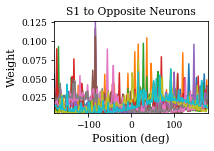

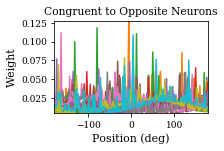

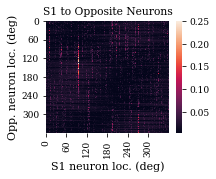

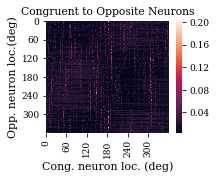

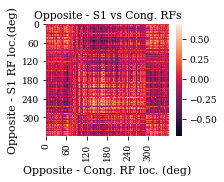

Total correltaion: -0.279


In [825]:
set_style(box=True)
y = ys[-1]
l, l2 = 2*N, -2*N
u, w = y[:l], y[l:l2]
l = N
uc, uo = u[:l], u[l:]
# rc, ro = [r(uci, uc, omega) for uci in uc], [r(uoi, uo, omega) for uoi in uo]
l = N*N
wc1, wc2, wo1, wo2 = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("S1 to Opposite Neurons")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), wo1[i])
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/wo1_RF.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("Congruent to Opposite Neurons")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), wo2[i])
# plt.yticks([0.05, 0.10, 0.15], ["0.05", "0.10", "0.15"])
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/wo2_RF.pdf")
plt.show()

corr = np.corrcoef(wo1, wo2)[:N,N:]
best_corr = np.corrcoef(wo1, -wo1)[:N,N:]
ideal = np.array([[W(1.0, a1_in)(theta1, theta2) for theta2 in thetas] for theta1 in thetas])
corr12_ideal = np.corrcoef(ideal, -ideal)[:N,N:]

plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
sns.heatmap(wo1)
plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.title("S1 to Opposite Neurons")
plt.ylabel("Opp. neuron loc. (deg)")
plt.xlabel("S1 neuron loc. (deg)")
# plt.savefig("Manuscript/Figures/wo1_matrix.png")
# cplt.savefig("Manuscript/Figures/wo1_matrix.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
sns.heatmap(wo2)
plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.title("Congruent to Opposite Neurons")
plt.ylabel("Opp. neuron loc.(deg)")
plt.xlabel("Cong. neuron loc. (deg)")
# plt.savefig("Manuscript/Figures/wo2_matrix.png")
# cplt.savefig("Manuscript/Figures/wo2_matrix.pdf")
plt.show()

corr1 = np.corrcoef(wo1, ideal)[:N,N:]
# plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
# sns.heatmap(corr1)
# plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.title("Opposite - S1 RFs vs Inputs")
# plt.ylabel("Opposite - S1 RF loc.(deg)")
# plt.xlabel("Input loc. (deg)")
# # plt.savefig("Manuscript/Figures/wo1_RF_input_corr.png")
# # cplt.savefig("Manuscript/Figures/wo1_RF_input_corr.pdf")
# plt.show()

corr2 = np.corrcoef(-wo2, ideal)[:N,N:]
# plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
# sns.heatmap(corr2)
# plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
# plt.title("Opposite - Cong. RFs vs Inputs")
# plt.ylabel("Opposite - Cong. RF loc.(deg)")
# plt.xlabel("Input loc. (deg)")
# # plt.savefig("Manuscript/Figures/wo2_RF_input_corr.png")
# # cplt.savefig("Manuscript/Figures/wo2_RF_input_corr.pdf")
# plt.show()

adjusted_corr = np.corrcoef(wo1, -wo2 @ np.linalg.inv(U))[:N,N:]
plt.figure(figsize=cplt.set_size("nips", fraction=0.5, ratio=0.75))
sns.heatmap(adjusted_corr)
plt.xticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.yticks(np.arange(0, 180, 30), np.arange(0, 360, 60))
plt.title("Opposite - S1 vs Cong. RFs")
plt.ylabel("Opposite - S1 RF loc.(deg)")
plt.xlabel("Opposite - Cong. RF loc. (deg)")
# plt.savefig("Manuscript/Figures/wo1_RF_wo2_RF_corr.png")
# cplt.savefig("Manuscript/Figures/wo1_RF_wo2_RF_corr.pdf")
plt.show()

tot_corr = np.corrcoef(adjusted_corr.flatten(), corr12_ideal.flatten())
print("Total correltaion: {:.3f}".format(tot_corr[0,1]))

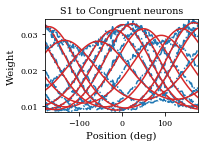

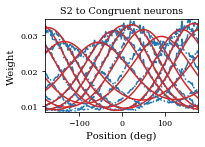

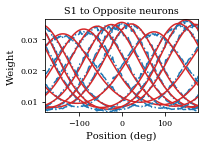

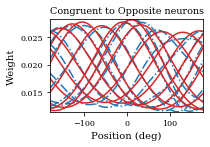

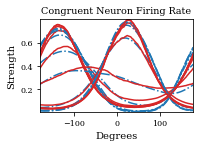

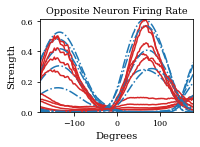

0.18524719043861784 1.8246483735743044
0.5656361701098385 0.07984321797445161
0.5862479591718295
0.18435534219861532 1.8270998990403293
0.5664863116488835 0.08155297537062368
0.587803456041376
0.261704780313326 1.7919384619155387
0.6971905657492544 0.054343351678337815
0.7041311293582704
-0.13718350634940146 1.815819591270253
0.38848688021787875 0.0322942586254675
0.3913938717837446
-0.9947280287284804 1.3447454321267054
1.3070683813388482 0.318672272052287
1.3822121071008557
-0.27361371431352205 1.848188867214719
1.4450717290687023 0.5739817830930369
1.4587362942539688


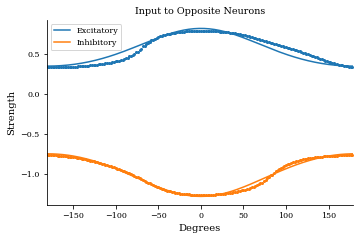

[-2.33011255  0.42940246] [0.01350996 0.00606652]
[1.0854584 0.2682154] [0.00843958 0.00230421]


In [625]:
def norm_tc(ws, axis=1, extra=True):
    integrals = np.sum(ws, axis=axis) * (2*np.pi / N)
    if extra:
        return (ws/integrals, integrals)
    return ws / integrals

def fit(nws, thetas=thetas):
    func = lambda theta, mu, kappa: M(mu, kappa)(theta)
    popt, pcov = curve_fit(func, thetas, nws, bounds=([-np.pi, 0], [np.pi, np.inf]))
    perr = np.sqrt(np.diag(pcov))
    return (M(*popt), popt, perr)

y = ys[-1]
l = 2*N
u, w = y[:l], y[l:]
l = N*N
rc = r(uc, uc, omega)
wc1, wc2, wo1, wo2 = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]
thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False)

(nwc1, iwc1), (nwc2, iwc2), (nwo1, iwo1), (nwo2, iwo2) = norm_tc(wc1), norm_tc(wc2), norm_tc(wo1), norm_tc(wo2)
all_rc, all_ro = all_rs
src, sro = all_rc[-180:], all_ro[-180:]
(nrc, irc), (nro, iro) = norm_tc(src), norm_tc(sro)

set_style(box=True)
plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("S1 to Congruent neurons")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), wc1[i], color="tab:blue", linestyle='-.')
    func, popt, perr = fit(nwc1[i])
    plt.plot(np.rad2deg(thetas), func(thetas)*iwc1, color="tab:red")
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/sample_fitting_wc1_with_vM.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("S2 to Congruent neurons")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), wc2[i], color="tab:blue", linestyle='-.')
    func, popt, perr = fit(nwc2[i])
    plt.plot(np.rad2deg(thetas), func(thetas)*iwc2, color="tab:red")
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/sample_fitting_wc2_with_vM.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("S1 to Opposite neurons")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), wo1[i], color="tab:blue", linestyle='-.')
    func, popt, perr = fit(nwo1[i])
    plt.plot(np.rad2deg(thetas), func(thetas)*iwo1, color="tab:red")
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/sample_fitting_wo1_with_vM.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("Congruent to Opposite neurons")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), wo2[i], color="tab:blue", linestyle='-.')
    func, popt, perr = fit(nwo2[i])
    plt.plot(np.rad2deg(thetas), func(thetas)*iwo2, color="tab:red")
# plt.yticks([0.1, 0.2], ["0.1", "0.2"])
plt.xlabel("Position (deg)")
plt.ylabel("Weight")
# cplt.savefig("Manuscript/Figures/sample_fitting_wo2_with_vM.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("Congruent Neuron Firing Rate")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), src[i], color="tab:blue", linestyle='-.')
    func, popt, perr = fit(nrc[i])
    plt.plot(np.rad2deg(thetas), func(thetas)*irc, color="tab:red")
plt.xlabel("Degrees")
plt.ylabel("Strength")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.5))
plt.title("Opposite Neuron Firing Rate")
for i in range(0,180,18):
    plt.plot(np.rad2deg(thetas), sro[i], color="tab:blue", linestyle='-.')
    func, popt, perr = fit(nro[i])
    plt.plot(np.rad2deg(thetas), func(thetas)*iro, color="tab:red")
    
plt.xlabel("Degrees")
plt.ylabel("Strength")
plt.show()

nwos = [nwc1, nwc2, nwo1, nwo2, nrc, nro]
avg_mus, avg_kappas = [], []

for k in range(len(nwos)):
    popts, perrs = np.zeros((N,2)), np.zeros((N,2))
    for i in range(N):
        _, popt, perr = fit(nwos[k][i])
        popts[i] = popt
        perrs[i] = perr
    avg_mu, avg_kappa = mean(popts, axis=0)
    std_mu, std_kappa = stddev(popts, axis=0)
    med_mu, med_kappa = np.median(popts, axis=0)
    avg_mus.append(avg_mu)
    avg_kappas.append(avg_kappa)
    print(avg_mu, std_mu)
    print(avg_kappa, std_kappa)
    print(med_kappa)

avg_tc1 = M(0.0, avg_kappas[0])(thetas)
avg_tc2 = M(0.0, avg_kappas[1])(thetas)
r1_input = M(0.0, a1_in)(thetas)
r2_input = M(0.0, a2_in)(thetas)

# I1_ff = norm_tc(convolve1d(r1_input, avg_tc1, mode="wrap"), axis=0)
# I2_ff = norm_tc(convolve1d(r2_input, avg_tc2, mode="wrap"), axis=0)
# plt.figure()
# plt.plot(np.rad2deg(thetas), I1_ff)
# plt.plot(np.rad2deg(thetas), I2_ff)
# func1, popt1, perr1 = fit(I1_ff)
# func2, popt2, perr2 = fit(I2_ff)
# plt.plot(np.rad2deg(thetas), func1(thetas))
# plt.plot(np.rad2deg(thetas), func2(thetas))
# plt.show()

actual_I1_ff, int1 = norm_tc(np.matmul(wo1, r1_input),axis=0, extra=True)
actual_I2_ff, int2 = norm_tc(-np.matmul(wo2, rc),axis=0, extra=True)
shift1 = np.pi - list(actual_I1_ff).index(max(actual_I1_ff))/N*2*np.pi
shift2 = np.pi - list(actual_I2_ff).index(max(actual_I2_ff))/N*2*np.pi
new_thetas1 = (thetas + shift1 + np.pi) % (2*np.pi) - np.pi
new_thetas2 = (thetas + shift2 + np.pi) % (2*np.pi) - np.pi

set_style(ymargin=0.05)
plt.figure(figsize=cplt.set_size("nips"))
plt.title("Input to Opposite Neurons")
plt.scatter(np.rad2deg(new_thetas1), actual_I1_ff*int1, color='C0', s=4.0)
plt.scatter(np.rad2deg(new_thetas2), actual_I2_ff*int2, color='C1', s=4.0)
func1, popt1, perr1 = fit(actual_I1_ff)
func2, popt2, perr2 = fit(actual_I2_ff)
plt.plot(np.rad2deg(thetas), func1(thetas + popt1[0])*int1, color='C0', label="Excitatory")
plt.plot(np.rad2deg(thetas), func2(thetas + popt2[0])*int2, color='C1', label="Inhibitory")
plt.xlabel("Degrees")
plt.ylabel("Strength")
plt.legend()
# cplt.savefig("Manuscript/Figures/Opposite_neurons_input.pdf")
plt.show()
print(popt1, perr1)
print(popt2, perr2)

In [604]:
all_wo1 = np.zeros((len(ys),N,N))
all_wo2 = np.zeros((len(ys),N,N))
all_rc = np.zeros((len(ys),N))
all_ro = np.zeros((len(ys),N))

for i in range(len(ys)):
    y = ys[i]
    l, l2 = 2*N, -2*N
    u, w, ths = y[:l], y[l:l2], y[l2:]
    l = N
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    thc, tho = ths[:l], ths[l:]
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    all_wo1[i] = wo1
    all_wo2[i] = wo2
    all_rc[i] = rc
    all_ro[i] = ro
    
# all_wo1 = np.transpose(all_wo1, (2,0,1))
# all_wo2 = np.transpose(all_wo2, (2,0,1))

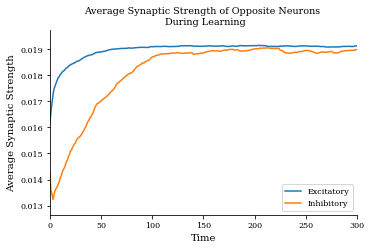

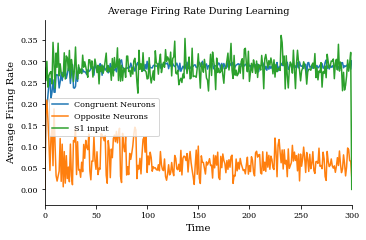

In [605]:
set_style(ymargin=0.1)
plt.figure(figsize=cplt.set_size("nips"))
plt.title("Average Synaptic Strength of Opposite Neurons \n During Learning")
plt.plot(list(range(len(ys))), np.average(all_wo1[:,0], axis=1), label="Excitatory")
plt.plot(list(range(len(ys))), np.average(all_wo2[:,0], axis=1), label="Inhibitory")
plt.xlabel("Time")
plt.ylabel("Average Synaptic Strength")
plt.legend()
# cplt.savefig("Manuscript/Figures/Opposite_neurons_synaptic_strength_during_learning.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips"))
plt.title("Average Firing Rate During Learning")
plt.plot(list(range(len(ys))), np.average(all_rc[:], axis=1), label="Congruent Neurons")
plt.plot(list(range(len(ys))), np.average(all_ro[:], axis=1), label="Opposite Neurons")
plt.plot(list(range(len(ys))), np.average(r1_in_save[:], axis=1), label="S1 input")
plt.xlabel("Time")
plt.ylabel("Average Firing Rate")
plt.legend(loc='upper left', bbox_to_anchor=(0.0, 0.6))
# cplt.savefig("Manuscript/Figures/Firing_rate_during_learning.pdf")
plt.show()

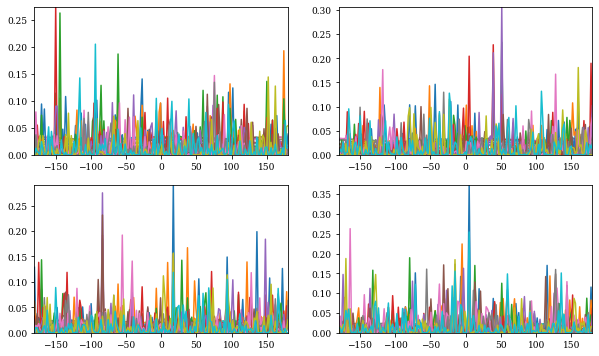

In [821]:
def get_corr(j=0):
    y = ys[j]
    l, l2 = 2*N, -2*N
    u, w, ths = y[:l], y[l:l2], y[l2:]
    l = N
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    thc, tho = ths[:l], ths[l:]
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]
    return (wc1, wc2, wo1, wo2)

fig, ((ax1, ax2), (ax5, ax6)) = plt.subplots(2,2, figsize=(10,6))
x = np.linspace(-180, 180, num=N)

def init():
    wc1, wc2, wo1, wo2 = get_corr()
    for i in range(0, N, 18):
        ax1.plot(x, wc1[i])
        ax2.plot(x, wc2[i])
        ax5.plot(x, wo1[i])
        ax6.plot(x, wo2[i])

def animate(j):
    ax1.clear()
    ax2.clear()
    ax5.clear()
    ax6.clear()
    wc1, wc2, wo1, wo2 = get_corr(j)
    for i in range(0, N, 18):
        ax1.plot(x, wc1[i])
        ax2.plot(x, wc2[i])
        ax5.plot(x, wo1[i])
        ax6.plot(x, wo2[i])

ani = animation.FuncAnimation(fig, animate, init_func=init, frames=np.arange(0, len(t), 8), interval=200, repeat=False)
ani

In [34]:
y = ys[0]
l = 2*N
u, w = y[:l], y[l:]
l = N*N
wc1, wc2, wo1, wo2 = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]
wc10, wc20, wo10, wo20 = wc1, wc2, wo1, wo2
new_s1 = s1[:]
new_s2 = s2[:]
new_r1_in = r1_in[:]
new_r2_in = r2_in[:]

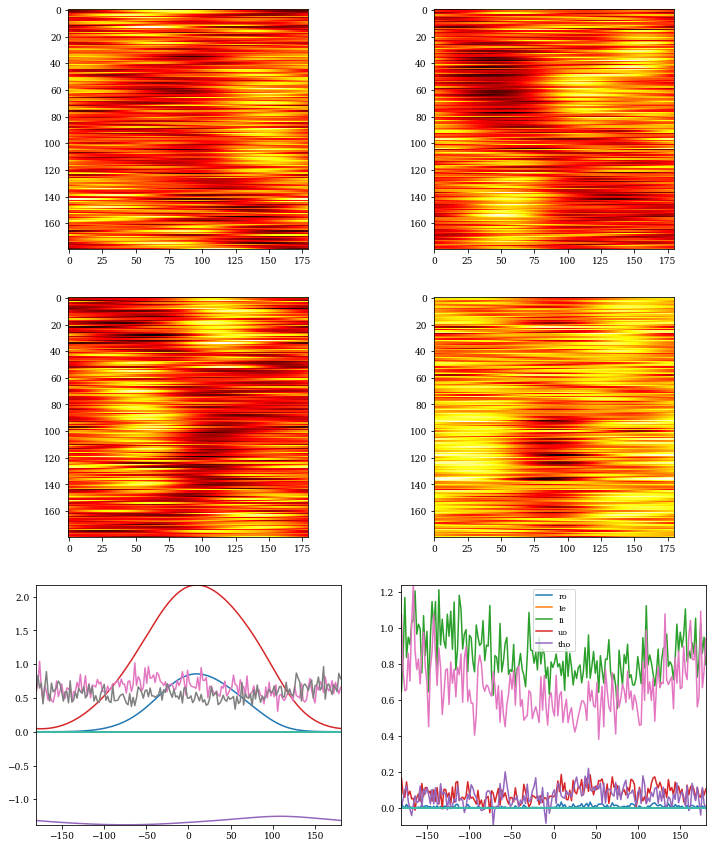

In [826]:
ideal = np.array([[W(1.0, a1_in)(theta1, theta2) for theta2 in thetas] for theta1 in thetas])
def get_corr(j=0):
    y = ys[j]
    l, l2 = 2*N, -2*N
    u, w, ths = y[:l], y[l:l2], y[l2:]
    l = N
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    thc, tho = ths[:l], ths[l:]
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]
    corr1 = np.corrcoef(wc1, ideal)[:N,N:]
    corr2 = np.corrcoef(wc2, ideal)[:N,N:]
    corr3 = np.corrcoef(wo1, ideal)[:N,N:]
    corr4 = np.corrcoef(wo2, -ideal)[:N,N:]
    Ie = np.matmul(wo1, r1_in_save[j])
    Ii = np.matmul(wo2, rc)
    I1 = np.matmul(wc1, r1_in_save[j])
    I2 = np.matmul(wc2, r2_in_save[j])
    return (corr1, corr2, corr3, corr4, uo, ro, Ie, Ii, tho, uc, rc, I1, I2, thc)

fig, ((ax1, ax2),(ax3, ax4), (ax5, ax6)) = plt.subplots(3,2, figsize=(12,15))
x = np.linspace(-180, 180, num=180)

def init():
    corr1, corr2, corr3, corr4, uo, ro, Ie, Ii, tho, uc, rc, I1, I2, thc = get_corr()
    hmap1 = ax1.imshow(corr1, cmap="hot")
    hmap2 = ax2.imshow(corr2, cmap="hot")
    hmap3 = ax3.imshow(corr3, cmap="hot")
    hmap4 = ax4.imshow(corr4, cmap="hot")
    ax6.plot(x, ro)
    ax6.plot(x, Ie)
    ax6.plot(x, Ii)
    ax6.plot(x, uo)
    ax6.plot(x, tho)
    ax5.plot(x, rc)
    ax5.plot(x, I1)
    ax5.plot(x, I2)
    ax5.plot(x, uc)
    ax5.plot(x, thc)

def animate(j):
    ax1.clear()
    ax2.clear()
    ax3.clear()
    ax4.clear()
    ax5.clear()
    ax6.clear()
    corr1, corr2, corr3, corr4, uo, ro, Ie, Ii, tho, uc, rc, I1, I2, thc = get_corr(j)
    hmap1 = ax1.imshow(corr1, cmap="hot")
    hmap2 = ax2.imshow(corr2, cmap="hot")
    hmap3 = ax3.imshow(corr3, cmap="hot")
    hmap4 = ax4.imshow(corr4, cmap="hot")
    ax6.plot(x, ro, label="ro")
    ax6.plot(x, Ie, label="Ie")
    ax6.plot(x, Ii, label="Ii")
    ax6.plot(x, uo, label="uo")
    ax6.plot(x, tho, label="tho")
    ax6.legend()
    ax5.plot(x, rc)
    ax5.plot(x, I1)
    ax5.plot(x, I2)
    ax5.plot(x, uc)
    ax5.plot(x, thc)

ani = animation.FuncAnimation(fig, animate, init_func=init, frames=np.arange(0, len(t), 8), interval=200, repeat=False)
ani

In [2142]:
ani.save("new_model_movie.mp4")

## Tuning curve

In [626]:
y = ys[-1]
l, l2 = 2*N, -2*N
u, w, ubs = y[:l], y[l:l2], y[l2:]
l = N*N
wc1f, wc2f, wo1f, wo2f = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]
ubcf, ubof = ubs[:N], ubs[N:]

In [425]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 3.0 # Input concentration of modality 1
a2_in = 3.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 2.1e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 5.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 5.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 60.0 # simulation time
save_interval = 300 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 4.5
Ibo = 1.7
alpha = 5.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
# print(len(save_ts))
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
s_ = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
s_ = np.concatenate((s_, s_))
s1 = np.repeat(np.deg2rad(s_), N_repeats)

# Generate stimulus location for modality 2
s2 = np.repeat(np.deg2rad(s_), N_repeats)

# Convert stimulus location to firing rate
# a1_ins = np.array([[a1_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# a2_ins = np.array([[a2_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
# r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
# r1_in = np.array([r_in(s1[i], 0.0, a1_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], 0.8*R2, a2_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], 0.0, a2_in) for i in range(n)] + [np.zeros(N)])

r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
# r1_in = np.array([r_in(s1[i], R1, 0.0) for i in range(n)] + [np.zeros(N)])
r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], R2, 0.0) for i in range(n)] + [np.zeros(N)])


# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = ubcf, ubof
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = np.zeros(N)
    dubodt = np.zeros(N)
#     dubcdt = 1/tau_b * (Ibc - uc)
#     dubodt = 1/tau_b * (Ibo - uo)
    ducdt = 1/tau * (-uc + ubc + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + ubo + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = np.zeros(N*N)
    dwc2dt = np.zeros(N*N)
    dwo1dt = np.zeros(N*N)
    dwo2dt = np.zeros(N*N)

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

KeyboardInterrupt: 

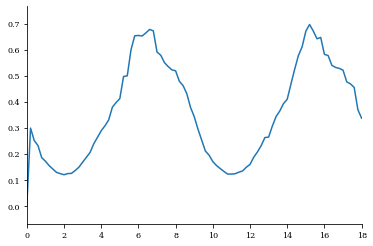

In [503]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 3.0 # Input concentration of modality 1
a2_in = 3.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 15.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 15.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 18.0 # simulation time
save_interval = 400 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 30.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
# print(len(save_ts))
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
s_ = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
s_ = np.concatenate((s_, s_))
s1 = np.repeat(np.deg2rad(s_), N_repeats)

# Generate stimulus location for modality 2
s2 = np.repeat(np.deg2rad(s_), N_repeats)

# Convert stimulus location to firing rate
# a1_ins = np.array([[a1_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# a2_ins = np.array([[a2_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
# r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
# r1_in = np.array([r_in(s1[i], 0.0, a1_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], 0.0, a2_in) for i in range(n)] + [np.zeros(N)])

r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
# r1_in = np.array([r_in(s1[i], R1, 0.0) for i in range(n)] + [np.zeros(N)])
r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], R2, 0.0) for i in range(n)] + [np.zeros(N)])


# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = ubcf, ubof
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = np.zeros(N)
    dubodt = np.zeros(N)
#     dubcdt = 1/tau_b * (Ibc - uc)
#     dubodt = 1/tau_b * (Ibo - uo)
    ducdt = 1/tau * (-uc - 0.4 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + 0.2 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = np.zeros(N*N)
    dwc2dt = np.zeros(N*N)
    dwo1dt = np.zeros(N*N)
    dwo2dt = np.zeros(N*N)

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

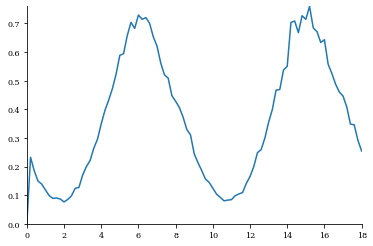

In [546]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 2.0 # Input concentration of modality 1
a2_in = 2.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 10.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 10.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 18.0 # simulation time
save_interval = 400 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 20.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
# print(len(save_ts))
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
s_ = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
s_ = np.concatenate((s_, s_))
s1 = np.repeat(np.deg2rad(s_), N_repeats)

# Generate stimulus location for modality 2
s2 = np.repeat(np.deg2rad(s_), N_repeats)

# Convert stimulus location to firing rate
# a1_ins = np.array([[a1_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# a2_ins = np.array([[a2_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
# r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
# r1_in = np.array([r_in(s1[i], 0.0, a1_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], 0.0, a2_in) for i in range(n)] + [np.zeros(N)])

r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
# r1_in = np.array([r_in(s1[i], R1, 0.0) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)])
r2_in = np.array([r_in(s2[i], R2, 0.0) for i in range(n)] + [np.zeros(N)])


# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = ubcf, ubof
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = np.zeros(N)
    dubodt = np.zeros(N)
#     dubcdt = 1/tau_b * (Ibc - uc)
#     dubodt = 1/tau_b * (Ibo - uo)
    ducdt = 1/tau * (-uc - 0.7 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + 0.2 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = np.zeros(N*N)
    dwc2dt = np.zeros(N*N)
    dwo1dt = np.zeros(N*N)
    dwo2dt = np.zeros(N*N)

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

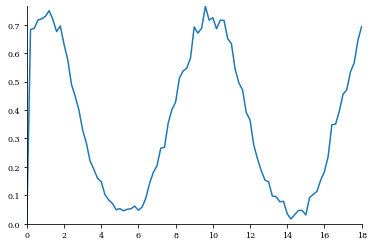

In [642]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 1.5 # Input concentration of modality 1
a2_in = 1.5 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau_stim = 0.1 # time per stimulus
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 10.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 10.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
T = 18.0 # simulation time
save_interval = 400 # save simulation state every SAVE_INTERVAL steps. Should be a number that divides T/delta_t.
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 15.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(n/save_interval)+1) # depends on ts
# print(len(save_ts))
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

N_repeats = int(round(tau_stim / delta_t)) # number of simulation steps for each big stimulus change
N_small = int(round(N_repeats/10)) # number of small stimulus changes within each big change
N_big = int(round(n/N_repeats)) # number of big stimulus changes

# Generate stimulus location for modality 1
s_ = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
s_ = np.concatenate((s_, s_))
s1 = np.repeat(np.deg2rad(s_), N_repeats)

# Generate stimulus location for modality 2
s2 = np.repeat(np.deg2rad(s_), N_repeats)

# Convert stimulus location to firing rate
# a1_ins = np.array([[a1_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# a2_ins = np.array([[a2_in for _ in range(N_repeats)] + [0.0 for _ in range(N_repeats)] for _ in range(int(n/2))]).flatten()
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))
# r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
# r1_in = np.array([r_in(s1[i], 0.0, a1_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], 0.0, a2_in) for i in range(n)] + [np.zeros(N)])

# r1_in = np.array([r_in(s1[i], R1, a1_in) for i in range(n)] + [np.zeros(N)])
r1_in = np.array([r_in(s1[i], R1, 0.0) for i in range(n)] + [np.zeros(N)])
r2_in = np.array([r_in(s2[i], R2, a2_in) for i in range(n)] + [np.zeros(N)])
# r2_in = np.array([r_in(s2[i], R2, 0.0) for i in range(n)] + [np.zeros(N)])


# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

# Initialize model
w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
u0 = np.zeros(2*N)
ubc0, ubo0 = ubcf, ubof
y0 = np.concatenate((u0, w0, ubc0, ubo0))

def dydt(t, y, i, avgs, all_rc):
    l, l2 = 2*N, -2*N
    u, w, ubs = y[:l], y[l:l2], y[l2:]
    l = N
    ubc, ubo = ubs[:l], ubs[l:]
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
    j = max(i-delay_n, 0)
    dubcdt = np.zeros(N)
    dubodt = np.zeros(N)
#     dubcdt = 1/tau_b * (Ibc - uc)
#     dubodt = 1/tau_b * (Ibo - uo)
    ducdt = 1/tau * (-uc - 1.2 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
    duodt = 1/tau * (-uo + 0.15 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
    dwc1dt = np.zeros(N*N)
    dwc2dt = np.zeros(N*N)
    dwo1dt = np.zeros(N*N)
    dwo2dt = np.zeros(N*N)

    return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
plt.plot(t, ys.T[N])
plt.show()

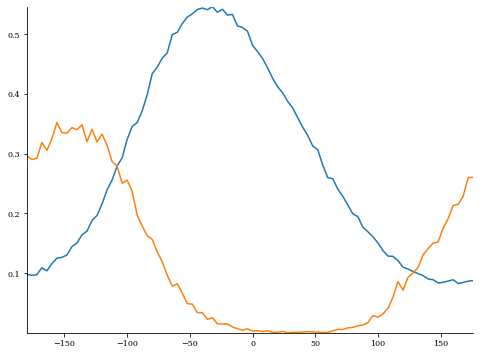

In [643]:
N_cut = int(len(all_rs[0])/2)
all_rc, all_ro = np.array(all_rs)[:,N_cut+1::N_repeats]
avg_c, avg_o = mean(all_rc, axis=1), mean(all_ro, axis=1)
all_uc = np.zeros((len(ys)-1, N))
all_uo = np.zeros((len(ys)-1, N))
tcs_c = all_rc.T
tcs_o = all_ro.T

set_style(ymargin=0.0)
plt.figure(figsize=(8,6))
x = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
plt.plot(x, tcs_c[0])
plt.plot(x, tcs_o[0])
# plt.plot(x, avg_c)
# plt.plot(x, avg_o)
plt.show()

In [644]:
# avg0_o = avg_o
# avg0_c = avg_c
# avg1_o = avg_o
# avg1_c = avg_c
# avg2_o = avg_o
# avg2_c = avg_c
# avg12_o = avg_o
# avg12_c = avg_c

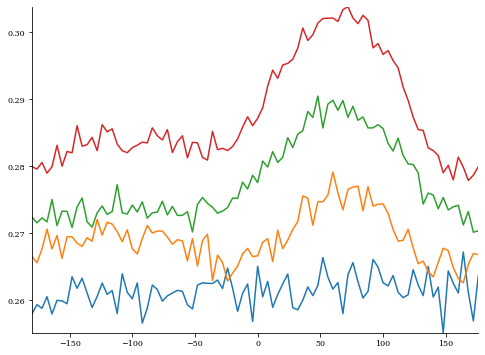

In [544]:
set_style(ymargin=0.0)
plt.figure(figsize=(8,6))
x = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
plt.plot(x, avg0_c)
plt.plot(x, avg1_c)
plt.plot(x, avg2_c)
plt.plot(x, avg12_c)
plt.show()

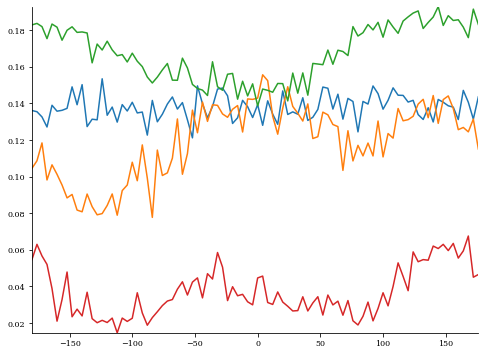

In [348]:
set_style(ymargin=0.0)
plt.figure(figsize=(8,6))
x = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
plt.plot(x, avg0_o)
plt.plot(x, avg1_o)
plt.plot(x, avg2_o)
plt.plot(x, avg12_o)
plt.show()

In [645]:
# tcs1_o = tcs_o
# tcs1_c = tcs_c
# tcs2_o = tcs_o
# tcs2_c = tcs_c
# tcs12_o = tcs_o
# tcs12_c = tcs_c

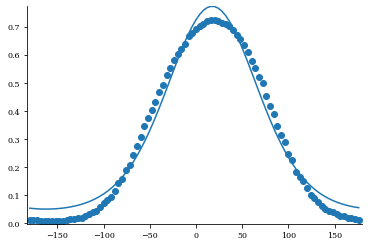

[1.87969172 0.30559137 1.37479662]


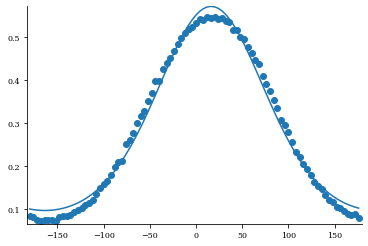

[1.78001637 0.28405586 0.88841164]


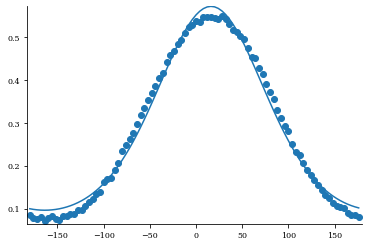

[1.77935977 0.28237686 0.89154889]


In [674]:
thetas = np.linspace(-np.pi, np.pi, num=len(tcs12_c[0]), endpoint=False)
x = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
i=30
func, popt = fit2(tcs12_c[i], thetas)
plt.plot(x, func(thetas))
plt.scatter(x, tcs12_c[i])
plt.show()
print(popt)
func, popt = fit2(tcs1_c[i], thetas)
plt.plot(x, func(thetas))
plt.scatter(x, tcs1_c[i])
plt.show()
print(popt)
func, popt = fit2(tcs2_c[i], thetas)
plt.plot(x, func(thetas))
plt.scatter(x, tcs2_c[i])
plt.show()
print(popt)

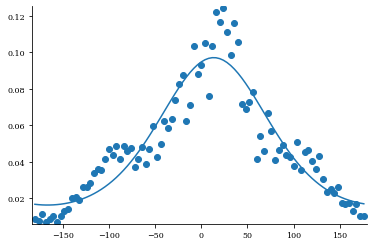

[0.3023804  0.23651252 0.89084531]


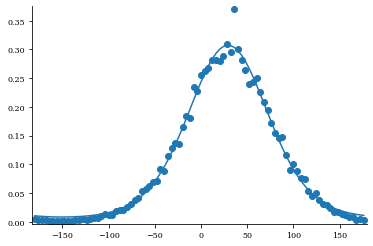

[0.63240785 0.51111549 1.81195772]


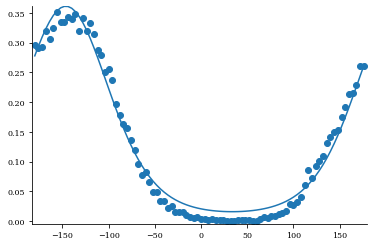

[ 0.81221979 -2.55376369  1.56485805]


In [676]:
thetas = np.linspace(-np.pi, np.pi, num=len(tcs12_c[0]), endpoint=False)
x = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
i=0
func, popt = fit2(tcs12_o[i], thetas)
plt.plot(x, func(thetas))
plt.scatter(x, tcs12_o[i])
plt.show()
print(popt)
func, popt = fit2(tcs1_o[i], thetas)
plt.plot(x, func(thetas))
plt.scatter(x, tcs1_o[i])
plt.show()
print(popt)
func, popt = fit2(tcs2_o[i], thetas)
plt.plot(x, func(thetas))
plt.scatter(x, tcs2_o[i])
plt.show()
print(popt)

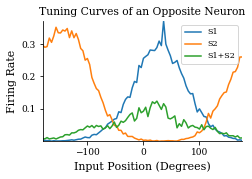

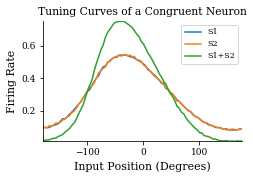

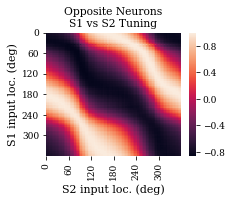

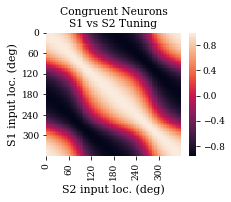

In [787]:
x = np.linspace(-180.0, 180.0, num=int(N_big/2), endpoint=False)
i = 0
j = 0
set_style(box=False)
plt.figure(figsize=cplt.set_size("nips", fraction=0.65))
plt.title("Tuning Curves of an Opposite Neuron")
plt.plot(x, tcs1_o[i], label="S1")
plt.plot(x, tcs2_o[i], label="S2")
plt.plot(x, tcs12_o[i], label="S1+S2")
plt.xlabel("Input Position (Degrees)")
plt.ylabel("Firing Rate")
plt.legend()
# cplt.savefig("Manuscript/Figures/Opposite_neuron_tuning_curves.pdf")
plt.show()

plt.figure(figsize=cplt.set_size("nips", fraction=0.65))
plt.title("Tuning Curves of a Congruent Neuron")
plt.plot(x, tcs1_c[i], label="S1")
plt.plot(x, tcs2_c[i], label="S2")
plt.plot(x, tcs12_c[i], label="S1+S2")
plt.xlabel("Input Position (Degrees)")
plt.ylabel("Firing Rate")
plt.legend()
# cplt.savefig("Manuscript/Figures/Congruent_neuron_tuning_curves.pdf")
plt.show()

N_int = int(N_big/2)
all_ro1, all_ro2 = tcs1_o.T, tcs2_o.T
corr = np.corrcoef(all_ro1, all_ro2)[:N_int,N_int:]
plt.figure(figsize=cplt.set_size("nips", fraction=0.55, ratio=0.75))
sns.heatmap(corr)
plt.xticks(np.arange(0, N_int, 15), np.arange(0, 360, 60))
plt.yticks(np.arange(0, N_int, 15), np.arange(0, 360, 60))
plt.title("Opposite Neurons\nS1 vs S2 Tuning")
plt.xlabel("S2 input loc. (deg)")
plt.ylabel("S1 input loc. (deg)")
# plt.savefig("Manuscript/Figures/Opposite_neuron_tuning_curves_correlation.png")
# cplt.savefig("Manuscript/Figures/Opposite_neuron_tuning_curves_correlation.pdf")
plt.show()

all_rc1, all_rc2 = tcs1_c.T, tcs2_c.T
corr = np.corrcoef(all_rc1, all_rc2)[:N_int,N_int:]
plt.figure(figsize=cplt.set_size("nips", fraction=0.55, ratio=0.75))
sns.heatmap(corr)
plt.xticks(np.arange(0, N_int, 15), np.arange(0, 360, 60))
plt.yticks(np.arange(0, N_int, 15), np.arange(0, 360, 60))
plt.title("Congruent Neurons\nS1 vs S2 Tuning")
plt.xlabel("S2 input loc. (deg)")
plt.ylabel("S1 input loc. (deg)")
# plt.savefig("Manuscript/Figures/Congruent_neuron_tuning_curves_correlation.png")
# cplt.savefig("Manuscript/Figures/Congruent_neuron_tuning_curves_correlation.pdf")
plt.show()

In [188]:
def fit2(nws, thetas):
    func = lambda theta, A, mu, kappa: A*M(mu, kappa)(theta)
    popt, pcov = curve_fit(func, thetas, nws, bounds=([0, -np.pi, 0], [10000, np.pi, np.inf]))
    return (lambda x: popt[0]*M(popt[1], popt[2])(x), popt)

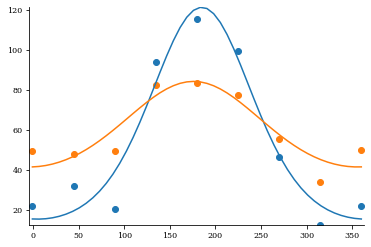

464.2335766423356 530.2007299270073
54.65978678311258 60.55926517290486
[348.92385274  -3.05411422   1.03141137] [3.83172117e+02 3.07023256e+00 3.54193900e-01]


In [190]:
high_R = np.loadtxt("blue_dots.csv", delimiter=",")
low_R = np.loadtxt("green_dots.csv", delimiter=",")
fhR, popt_hR = fit2(high_R[:,1], np.deg2rad(high_R[:,0]))
flR, popt_lR = fit2(low_R[:,1], np.deg2rad(low_R[:,0]))
plt.scatter(high_R[:,0], high_R[:,1])
plt.scatter(low_R[:,0], low_R[:,1])
xh = np.linspace(high_R[0,0], high_R[-1,0])
xl = np.linspace(low_R[0,0], low_R[-1,0])
plt.plot(xh, fhR(np.deg2rad(xh)))
plt.plot(xl, flR(np.deg2rad(xl)))
plt.show()
shR = sum(high_R[:,1])
slR = sum(low_R[:,1])
print(shR, slR)
print(mean(fhR(np.deg2rad(xh))), mean(flR(np.deg2rad(xl))))
print(popt_hR, popt_lR)

In [136]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 3.0 # Input concentration of modality 1
a2_in = 3.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 15.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 15.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 0.75
Ibo = 0.25
alpha = 30.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

# Simulation length settings
T = 0.2 # simulation time
save_time = T # save simulation state every SAVE_TIME time.
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(T/save_time)+1) # depends on ts

# Convert stimulus location to firing rate
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

reliability = [1.0, 0.75, 0.5, 0.25]
num = 9
s1_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
s2_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
results = np.zeros((len(reliability), num, num, 2, N))
for i in range(len(reliability)):
    for j in range(len(s1_loc)):
        for k in range(len(s2_loc)):
            print(i*(num**2)+j*num+k)
#             r1_in = np.array([r_in(s1_loc[j], R1*reliability[i], a1_in) for _ in range(n)] + [np.zeros(N)])
            r1_in = np.array([r_in(s1_loc[j], R1, a1_in*reliability[i]) for _ in range(n)] + [np.zeros(N)])
            r2_in = np.array([r_in(s2_loc[k], R2, a2_in) for _ in range(n)] + [np.zeros(N)])
            
            # Initialize model
            w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
            u0 = np.zeros(2*N)
            ubc0, ubo0 = ubcf, ubof
            y0 = np.concatenate((u0, w0, ubc0, ubo0))
            
            def dydt(t, y, i, avgs, all_rc):
                l, l2 = 2*N, -2*N
                u, w, ubs = y[:l], y[l:l2], y[l2:]
                l = N
                ubc, ubo = ubs[:l], ubs[l:]
                uc, uo = u[:l], u[l:]
                rc, ro = r(uc, uc, omega), r(uo, uo, omega)
                l = N*N
                wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
                j = max(i-delay_n, 0)
                dubcdt = np.zeros(N)
                dubodt = np.zeros(N)
                ducdt = 1/tau * (-uc - 0.4 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
                duodt = 1/tau * (-uo + 0.2 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
                dwc1dt = np.zeros(N*N)
                dwc2dt = np.zeros(N*N)
                dwo1dt = np.zeros(N*N)
                dwo2dt = np.zeros(N*N)
                return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))
            
            t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
            all_rc, all_ro = all_rs
#             plt.plot(ts, all_ro[1:,0])
#             plt.show()
            results[i][j][k][0] = all_rc[-1]
            results[i][j][k][1] = all_ro[-1]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [460]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 2.0 # Input concentration of modality 1
a2_in = 2.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 10.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 10.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 20.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

# Simulation length settings
T = 0.2 # simulation time
save_time = T # save simulation state every SAVE_TIME time.
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(T/save_time)+1) # depends on ts

# Convert stimulus location to firing rate
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

reliability = [1.0, 0.75, 0.5, 0.25]
num = 9
s1_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
s2_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
results = np.zeros((len(reliability), num, num, 2, N))
for i in range(len(reliability)):
    for j in range(len(s1_loc)):
        for k in range(len(s2_loc)):
            print(i*(num**2)+j*num+k)
#             r1_in = np.array([r_in(s1_loc[j], R1*reliability[i], a1_in) for _ in range(n)] + [np.zeros(N)])
            r1_in = np.array([r_in(s1_loc[j], R1, a1_in*reliability[i]) for _ in range(n)] + [np.zeros(N)])
            r2_in = np.array([r_in(s2_loc[k], R2, a2_in) for _ in range(n)] + [np.zeros(N)])
            
            # Initialize model
            w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
            u0 = np.zeros(2*N)
            ubc0, ubo0 = ubcf, ubof
            y0 = np.concatenate((u0, w0, ubc0, ubo0))
            
            def dydt(t, y, i, avgs, all_rc):
                l, l2 = 2*N, -2*N
                u, w, ubs = y[:l], y[l:l2], y[l2:]
                l = N
                ubc, ubo = ubs[:l], ubs[l:]
                uc, uo = u[:l], u[l:]
                rc, ro = r(uc, uc, omega), r(uo, uo, omega)
                l = N*N
                wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
                j = max(i-delay_n, 0)
                dubcdt = np.zeros(N)
                dubodt = np.zeros(N)
                ducdt = 1/tau * (-uc + ubc + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
                duodt = 1/tau * (-uo + ubo + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
                dwc1dt = np.zeros(N*N)
                dwc2dt = np.zeros(N*N)
                dwo1dt = np.zeros(N*N)
                dwo2dt = np.zeros(N*N)
                return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))
            
            t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
            all_rc, all_ro = all_rs
#             plt.plot(ts, all_ro[1:,0])
#             plt.show()
            results[i][j][k][0] = all_rc[-1]
            results[i][j][k][1] = all_ro[-1]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [717]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 1.5 # Input concentration of modality 1
a2_in = 1.5 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 10.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 10.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 15.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

# Simulation length settings
T = 0.2 # simulation time
save_time = T # save simulation state every SAVE_TIME time.
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(T/save_time)+1) # depends on ts

# Convert stimulus location to firing rate
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

reliability = [1.0, 0.75, 0.5, 0.25]
num = 9
s1_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
s2_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
results = np.zeros((len(reliability), num, num, 2, N))
for i in range(len(reliability)):
    for j in range(len(s1_loc)):
        for k in range(len(s2_loc)):
            print(i*(num**2)+j*num+k)
#             r1_in = np.array([r_in(s1_loc[j], R1*reliability[i], a1_in) for _ in range(n)] + [np.zeros(N)])
            r1_in = np.array([r_in(s1_loc[j], R1, a1_in*reliability[i]) for _ in range(n)] + [np.zeros(N)])
            r2_in = np.array([r_in(s2_loc[k], R2, a2_in) for _ in range(n)] + [np.zeros(N)])
            
            # Initialize model
            w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
            u0 = np.zeros(2*N)
            ubc0, ubo0 = ubcf, ubof
            y0 = np.concatenate((u0, w0, ubc0, ubo0))
            
            def dydt(t, y, i, avgs, all_rc):
                l, l2 = 2*N, -2*N
                u, w, ubs = y[:l], y[l:l2], y[l2:]
                l = N
                ubc, ubo = ubs[:l], ubs[l:]
                uc, uo = u[:l], u[l:]
                rc, ro = r(uc, uc, omega), r(uo, uo, omega)
                l = N*N
                wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
                j = max(i-delay_n, 0)
                dubcdt = np.zeros(N)
                dubodt = np.zeros(N)
                ducdt = 1/tau * (-uc - 1.2 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
                duodt = 1/tau * (-uo + 0.15 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
                dwc1dt = np.zeros(N*N)
                dwc2dt = np.zeros(N*N)
                dwo1dt = np.zeros(N*N)
                dwo2dt = np.zeros(N*N)
                return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))
            
            t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
            all_rc, all_ro = all_rs
#             plt.plot(ts, all_ro[1:,0])
#             plt.show()
            results[i][j][k][0] = all_rc[-1]
            results[i][j][k][1] = all_ro[-1]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [461]:
def wrap(res):
    x0 = np.array([res[0]])
    new_res = np.append(res, x0, axis=0)
    y0 = np.array([new_res[:,0]]).T
    new_res = np.append(new_res, y0, axis=1)
    return new_res

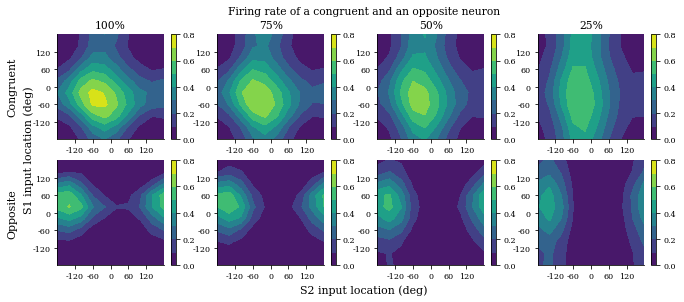

In [740]:
neuron = 0
fig, axes = plt.subplots(2,4,figsize=(cplt.set_size("nips")[0]*2, cplt.set_size("nips")[1]*1.25))
x = np.linspace(-180.0, 180.0, num=len(s1_loc)+1)
y = np.linspace(-180.0, 180.0, num=len(s2_loc)+1)
levels = np.linspace(0.0, 0.8, num=9)
titles = ["100%", "75%", "50%", "25%"]
ticks = [-120, -60, 0, 60, 120]
for i in range(len(reliability)):
    c0 = axes[0][i].contourf(y, x, wrap(results[i,:,:,0,neuron]), levels, cmap="viridis")
    c1 = axes[1][i].contourf(y, x, wrap(results[i,:,:,1,neuron]), levels, cmap="viridis")
    fig.colorbar(c0, ax=axes[0][i], ticks=[0.0, 0.2, 0.4, 0.6, 0.8])
    fig.colorbar(c1, ax=axes[1][i], ticks=[0.0, 0.2, 0.4, 0.6, 0.8])
    axes[0][i].set_title(titles[i])
    axes[0][i].set_xticks(ticks)
    axes[0][i].set_xticklabels(ticks)
    axes[0][i].set_yticks(ticks)
    axes[0][i].set_yticklabels(ticks)
    axes[1][i].set_xticks(ticks)
    axes[1][i].set_xticklabels(ticks)
    axes[1][i].set_yticks(ticks)
    axes[1][i].set_yticklabels(ticks)

axes[0][0].set_ylabel("Congruent", labelpad=15)
axes[1][0].set_ylabel("Opposite", labelpad=15)
fig.add_subplot(111, frameon=False)
plt.title("Firing rate of a congruent and an opposite neuron", pad=20)
# plt.colorbar(c0)
# hide tick and tick label of the big axis
plt.tick_params(labelcolor='none', top=False, bottom=False, left=False, right=False)
plt.xlabel("S2 input location (deg)")
plt.ylabel("S1 input location (deg)")
# cplt.savefig("Manuscript/Figures/Bimodal_reliability.pdf")
plt.show()

In [2806]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 3.0 # Input concentration of modality 1
a2_in = 3.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 15.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 15.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 0.75
Ibo = 0.25
alpha = 20.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

# Simulation length settings
T = 0.2 # simulation time
save_time = T # save simulation state every SAVE_TIME time.
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(T/save_time)+1) # depends on ts

# Convert stimulus location to firing rate
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

reliability = [1.0,0.8,0.6,0.4,0.2,0.0]
num = 20
s1_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
results = np.zeros((len(reliability), num, 2, N))
for i in range(len(reliability)):
    for j in range(len(s1_loc)):
        print(i*(num)+j)
#         r1_in = np.array([r_in(s1_loc[j], R1*reliability[i], a1_in) for _ in range(n)] + [np.zeros(N)])
#         r2_in = np.array([r_in(0.0, 0.0, a2_in) for _ in range(n)] + [np.zeros(N)])
        r1_in = np.array([r_in(s1_loc[j], R1, a1_in*reliability[i]) for _ in range(n)] + [np.zeros(N)])
        r2_in = np.array([r_in(0.0, R2, 0.0) for _ in range(n)] + [np.zeros(N)])

        # Initialize model
        w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
        u0 = np.zeros(2*N)
        ubc0, ubo0 = ubcf, ubof
        y0 = np.concatenate((u0, w0, ubc0, ubo0))

        def dydt(t, y, i, avgs, all_rc):
            l, l2 = 2*N, -2*N
            u, w, ubs = y[:l], y[l:l2], y[l2:]
            l = N
            ubc, ubo = ubs[:l], ubs[l:]
            uc, uo = u[:l], u[l:]
            rc, ro = r(uc, uc, omega), r(uo, uo, omega)
            l = N*N
            wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
            j = max(i-delay_n, 0)
            dubcdt = np.zeros(N)
            dubodt = np.zeros(N)
            ducdt = 1/tau * (-uc + ubc + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
            duodt = 1/tau * (-uo + ubo + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
            dwc1dt = np.zeros(N*N)
            dwc2dt = np.zeros(N*N)
            dwo1dt = np.zeros(N*N)
            dwo2dt = np.zeros(N*N)
            return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

        t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
        all_rc, all_ro = all_rs
#             plt.plot(ts, all_ro[1:,0])
#             plt.show()
        results[i][j][0] = all_rc[-1]
        results[i][j][1] = all_ro[-1]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119


In [741]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 1.5 # Input concentration of modality 1
a2_in = 1.5 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 1.6e-2
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 10.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 10.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 1.0
Ibo = 0.25
alpha = 15.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

# Simulation length settings
T = 0.2 # simulation time
save_time = T # save simulation state every SAVE_TIME time.
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(T/save_time)+1) # depends on ts

# Convert stimulus location to firing rate
# lamb = lambda s, R, a: lambda theta_j: R*np.exp(a*np.cos(s-theta_j)-a) # von Mises distribution of mean firing rate
lamb = lambda s, R, a: lambda theta_j: np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

reliability = [1.0,0.8,0.6,0.4,0.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0]
reliability2 = [0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.8,0.6,0.4,0.2,0.0]
num = 20
s1_loc = np.linspace(-np.pi, np.pi, num=num, endpoint=False)
results = np.zeros((len(reliability), num, 2, N))
for i in range(len(reliability)):
    for j in range(len(s1_loc)):
        print(i*(num)+j)
#         r1_in = np.array([r_in(s1_loc[j], R1*reliability[i], a1_in) for _ in range(n)] + [np.zeros(N)])
#         r2_in = np.array([r_in(0.0, 0.0, a2_in) for _ in range(n)] + [np.zeros(N)])
        r1_in = np.array([r_in(s1_loc[j], R1, a1_in*reliability[i]) for _ in range(n)] + [np.zeros(N)])
        r2_in = np.array([r_in(s1_loc[j], R2, a2_in*reliability2[i]) for _ in range(n)] + [np.zeros(N)])

        # Initialize model
        w0 = np.concatenate((wc1f.flatten(), wc2f.flatten(), wo1f.flatten(), wo2f.flatten()))
        u0 = np.zeros(2*N)
        ubc0, ubo0 = ubcf, ubof
        y0 = np.concatenate((u0, w0, ubc0, ubo0))

        def dydt(t, y, i, avgs, all_rc):
            l, l2 = 2*N, -2*N
            u, w, ubs = y[:l], y[l:l2], y[l2:]
            l = N
            ubc, ubo = ubs[:l], ubs[l:]
            uc, uo = u[:l], u[l:]
            rc, ro = r(uc, uc, omega), r(uo, uo, omega)
            l = N*N
            wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
            j = max(i-delay_n, 0)
            dubcdt = np.zeros(N)
            dubodt = np.zeros(N)
            ducdt = 1/tau * (-uc - 1.2 + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
            duodt = 1/tau * (-uo + 0.15 + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
            dwc1dt = np.zeros(N*N)
            dwc2dt = np.zeros(N*N)
            dwo1dt = np.zeros(N*N)
            dwo2dt = np.zeros(N*N)
            return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

        t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
        all_rc, all_ro = all_rs
#             plt.plot(ts, all_ro[1:,0])
#             plt.show()
        results[i][j][0] = all_rc[-1]
        results[i][j][1] = all_ro[-1]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239


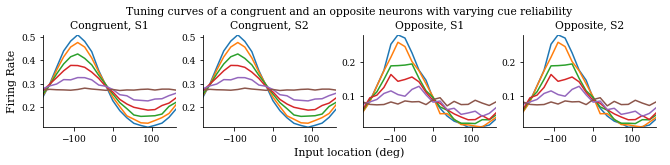

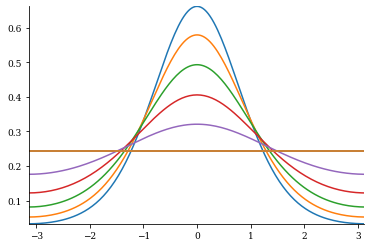

In [744]:
neuron = 155
set_style(ymargin=0.0)
fig, axes = plt.subplots(1,4,figsize=(cplt.set_size("nips")[0]*2, cplt.set_size("nips")[1]*0.5))
x = np.linspace(-180.0, 180.0, num=len(s1_loc), endpoint=False)
k = int(len(reliability)/2)
titles = ["Congruent, S1", "Congruent, S2", "Opposite, S1", "Opposite, S2"]
for i in range(k):
    axes[0].plot(x, results[i,:,0,neuron], label=str(reliability[i]))
    axes[1].plot(x, results[i,:,0,neuron], label=str(reliability2[i]))
for i in range(k, k*2):
    axes[2].plot(x, results[i,:,1,neuron], label=str(reliability[i]))
    axes[3].plot(x, results[i,:,1,neuron], label=str(reliability2[i]))
# plt.legend()
for i in range(4):
    axes[i].set_title(titles[i])
fig.add_subplot(111, frameon=False)
plt.title("Tuning curves of a congruent and an opposite neurons with varying cue reliability", pad=20)
# hide tick and tick label of the big axis
plt.tick_params(labelcolor='none', top=False, bottom=False, left=False, right=False)
plt.xlabel("Input location (deg)")
plt.ylabel("Firing Rate")
# cplt.savefig("Manuscript/Figures/Unimodal_reliability.pdf")
plt.show()

r1_inss = [lamb(0.0, R1, a1_in*reliability[i])(thetas) for i in range(len(reliability))]
for i in range(len(reliability)):
    plt.plot(thetas, r1_inss[i])
plt.show()

In [2507]:
# Parameters
N = 180 # Number of neurons per module
a1_in = 3.0 # Input concentration of modality 1
a2_in = 3.0 # Input concentration of modality 2
a_rc = 3.0 # Recurrent connections concentration
omega = 2.1e-2
tau = 0.01 # time constant of leaky integrator
delta_t = 0.05 * tau # simulation timestep
tau_we = 5.0 # time constant of synaptic weight change of excitatory neurons
tau_wi = 5.0 # time constant of synaptic weight change of inhibitory neurons
tau_b = 5.0 # time constant of threshold change
delay = 0.02 # delay of signal from C to O
F = 0.5 # Fano factor, controls variance of firing rate
R1 = 1.0 # Maximum mean firing rate for modality 1
R2 = 1.0 # Maximum mean firing rate for modality 2
Ibc = 4.5
Ibo = 1.3
alpha = 5.0 # Controls strength of anti-hebbian connections, the larger the weaker.

thetas = np.linspace(-np.pi, np.pi, num=N, endpoint=False) # depends on N
delay_n = int(round(delay/delta_t)) # Number of timesteps to delay for

# Simulation length settings
T = 0.2 # simulation time
save_time = T # save simulation state every SAVE_TIME time.
n = int(round(T / delta_t)) # Number of timesteps # depends on T and delta_t
ts = np.linspace(0.0, T, num=n, endpoint=False) # depends on n
save_ts = np.linspace(0.0, T, num=int(T/save_time)+1) # depends on ts

# Convert stimulus location to firing rate
lamb = lambda s, R, a: lambda theta_j: R*np.exp(-3.0)*i0(3.0)/i0(a)*np.exp(a*np.cos(s-theta_j)) # von Mises distribution of mean firing rate
r_in = lambda s, R, a: np.maximum(lamb(s,R,a)(thetas) + np.sqrt(F*lamb(s,R,a)(thetas))*np.random.normal(size=N), np.zeros(len(thetas)))

# Set up recurrent connections
rho = N/(2*np.pi)
J_crit2 = lambda a: np.sqrt(1/(rho*i0(a)) * 8*np.pi*omega*i0(a/2)**2)
W = lambda J, a: lambda theta1, theta2: J / (2*np.pi * i0(a)) * np.exp(a*np.cos(theta1 - theta2))
wro = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)
wrc = W(0.5*J_crit2(a_rc), a_rc)(thetas, 0)

num = 100
input_strength = np.linspace(0.0, 1.0, num=num)
results = np.zeros((num, 2, N))
for i in range(len(input_strength)):
    print(i)
    r1_in = np.array([r_in(0.0, R1, a1_in) for _ in range(n)] + [np.zeros(N)])
    r2_in = np.array([r_in(0.0, R2, a2_in) for _ in range(n)] + [np.zeros(N)])

    # Initialize model
    eye = np.array([[W(0.01*np.exp(-3.0)*i0(3.0)*2*np.pi, a1_in*input_strength[i])(j, k) for k in thetas] for j in thetas])
    w0 = np.concatenate((eye.flatten(), eye.flatten(), eye.flatten(), eye.flatten()))
    u0 = np.zeros(2*N)
    ubc0, ubo0 = np.zeros(N), np.zeros(N)
    y0 = np.concatenate((u0, w0, ubc0, ubo0))

    def dydt(t, y, i, avgs, all_rc):
        l, l2 = 2*N, -2*N
        u, w, ubs = y[:l], y[l:l2], y[l2:]
        l = N
        ubc, ubo = ubs[:l], ubs[l:]
        uc, uo = u[:l], u[l:]
        rc, ro = r(uc, uc, omega), r(uo, uo, omega)
        l = N*N
        wc1, wc2, wo1, wo2 = [np.reshape(w[j*l:(j+1)*l], (N,N)) for j in range(4)]
        j = max(i-delay_n, 0)
        dubcdt = np.zeros(N)
        dubodt = np.zeros(N)
        ducdt = 1/tau * (-uc + ubc + convolve1d(rc, wrc, mode="wrap") + np.dot(wc1, r1_in[i]) + np.dot(wc2, r2_in[i]))
        duodt = 1/tau * (-uo + ubo + convolve1d(ro, wro, mode="wrap") + np.dot(wo1, r1_in[i]) - np.dot(wo2, all_rc[j]))
        dwc1dt = np.zeros(N*N)
        dwc2dt = np.zeros(N*N)
        dwo1dt = np.zeros(N*N)
        dwo2dt = np.zeros(N*N)
        return np.concatenate((ducdt, duodt, dwc1dt.flatten(), dwc2dt.flatten(), dwo1dt.flatten(), dwo2dt.flatten(), dubcdt, dubodt))

    t, ys, r1_in_save, r2_in_save, all_rs = Newton(dydt, y0, ts, save_ts, progress=False)
    all_rc, all_ro = all_rs
#     plt.plot(ts, all_rc[1:,90])
#     plt.show()
    results[i][0] = all_rc[-1]
    results[i][1] = all_ro[-1]

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99


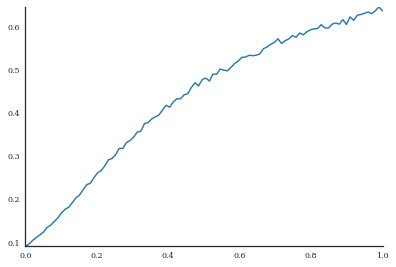

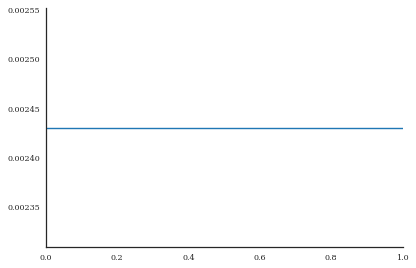

In [2509]:
plt.plot(input_strength, results[:,0,90])
# plt.xlim(0,0.05)
# plt.xscale("log")
plt.show()
w = np.array([W(0.01*np.exp(-3.0)*i0(3.0)*2*np.pi, a1_in*input_strength[i])(0.0, thetas) for R in input_strength])
plt.plot(input_strength, np.average(w, axis=1))
plt.show()

In [13]:
# my_reset('wc10', 'wc20', 'wo10', 'wo20', 'new_s1', 'new_s2', 'new_r1_in', 
#          'new_r2_in', 'wc1f', 'wc2f', 'wo1f', 'wo2f', 'thcf', 'thof',
#          'tcs1_o', 'tcs1_c', 'tcs2_o', 'tcs2_c', 'tcs12_o', 'tcs12_c')
# my_reset('wc10', 'wc20', 'wo10', 'wo20', 'new_s1', 'new_s2', 'new_r1_in', 
#          'new_r2_in', 'wc1f', 'wc2f', 'wo1f', 'wo2f', 'thcf', 'thof',
#          'tcs12_o', 'tcs12_c')
my_reset()

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


ERROR:root:Invalid alias: The name clear can't be aliased because it is another magic command.
ERROR:root:Invalid alias: The name more can't be aliased because it is another magic command.
ERROR:root:Invalid alias: The name less can't be aliased because it is another magic command.
ERROR:root:Invalid alias: The name man can't be aliased because it is another magic command.


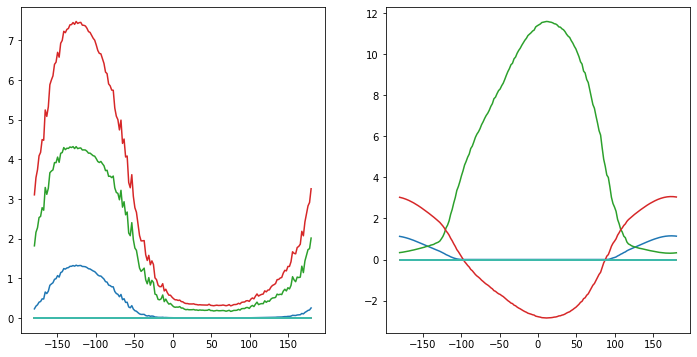

In [2241]:
a = 3.0
ideal = np.array([[W(J, a)(theta1, theta2) for theta2 in thetas] for theta1 in thetas])
def get_corr(j=0):
    y = ys[j]
    l, l2 = 2*N, -2*N
    u, w, ths = y[:l], y[l:l2], y[l2:]
    l = N
    uc, uo = u[:l], u[l:]
    rc, ro = r(uc, uc, omega), r(uo, uo, omega)
    thc, tho = ths[:l], ths[l:]
    l = N*N
    wc1, wc2, wo1, wo2 = [np.reshape(w[i*l:(i+1)*l], (N,N)) for i in range(4)]
    Ie = np.matmul(wo1, r1_in[j*200-1])
    Ii = np.matmul(wo2, rc)
    I1 = np.matmul(wc1, r1_in[j*200-1])
    I2 = np.matmul(wc2, r2_in[j*200-1])
    return (uo, ro, Ie, Ii, tho, uc, rc, I1, I2, thc)

fig, (ax5, ax6) = plt.subplots(1,2, figsize=(12,6))
x = np.linspace(-180, 180, num=180)

def init():
    uo, ro, Ie, Ii, tho, uc, rc, I1, I2, thc = get_corr()
    ax6.plot(x, ro)
    ax6.plot(x, Ie)
    ax6.plot(x, -Ii)
    ax6.plot(x, uo)
    ax6.plot(x, tho)
    ax5.plot(x, rc)
    ax5.plot(x, I1)
    ax5.plot(x, I2)
    ax5.plot(x, uc)
    ax5.plot(x, thc)

def animate(j):
    ax5.clear()
    ax6.clear()
    uo, ro, Ie, Ii, tho, uc, rc, I1, I2, thc = get_corr(j)
    ax6.plot(x, ro)
    ax6.plot(x, Ie)
    ax6.plot(x, -Ii)
    ax6.plot(x, uo)
    ax6.plot(x, tho)
    ax5.plot(x, rc)
    ax5.plot(x, I1)
    ax5.plot(x, I2)
    ax5.plot(x, uc)
    ax5.plot(x, thc)

ani = animation.FuncAnimation(fig, animate, init_func=init, frames=np.arange(0, len(t), 1), interval=200, repeat=False)
ani